# Fast front-prop

Fast front-prop implementation on matrices (see original `front-prop` idea in original notebook).
This one is ~100x faster, by parallelising all neurons in the layer.

In [155]:
import numpy as np
import matplotlib.pyplot as plt
import math
import scipy
from scipy.spatial import distance
from sklearn.metrics import mean_squared_error
import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm.autonotebook import tqdm
from functools import partial
from scipy.special import expit, logit
from sklearn.preprocessing import normalize

In [3]:
np.set_printoptions(formatter={'float': lambda x: "{0:0.2f}".format(x)})


In [4]:
"""
Calculate discrete entropy for continuous values, by binning them.
Note this is Shannon's measure of information entropy.
Not cross-entropy loss, used commonly in training.
"""
def entropy(numbers, range=(0, 1), bins=100):
    h, bin_edges = np.histogram(numbers, bins=bins, density=False, range=range)
    h = h / h.max() # normalise
    entropy = scipy.stats.entropy(h)
    return entropy


In [186]:
class FastLayer:
    """
    Fast implementation of front-prop. 
    Original was done with each Neuron being separate class and using "for" loops.
    This implementation uses a single matrix for all neurons (neurons_count x input_size).
    Weight and threshold updates are done for all neurons in parallel, but still for every single input.
    
    TODO: 
    It should be possible to do inference in mini-batches (many inputs in parallel) to make it even faster.
    """
    
#     T_DECAY_DEFAULT=0.0001
#     W_BOOST_DEFAULT=0.01
    T_DECAY_DEFAULT = 0.0005
    W_BOOST_DEFAULT = 0.02
    
    def __init__(self, input_size, output_size, t_decay=T_DECAY_DEFAULT, w_boost=W_BOOST_DEFAULT, 
                 # init=np.random.rand
                 # TODO: try normal distro
                 # init = partial(np.random.uniform, low=-1, high=1)):
                 init = partial(np.random.normal, loc=0, scale=1)):
                 
        self.input_size = input_size
        self.output_size = output_size
        self.t_decay = t_decay
        self.w_boost = w_boost
        self.frozen = False
        
        assert self.t_decay > 0        
        assert self.w_boost > 0
        
        # LAYER PARAMETERS:
        
        # input_size = number of synapses (weights) of each neuron
        # output_size = number of neurons in the layer
        self.W = init(size = (output_size, input_size))
        
        # FIXME do this only for LIN:
        self.W = normalize(self.W, axis=1)
        
        self.t = np.ones(output_size)
        
        self.reset_output()
        
        self.__assert()
        
    def __assert(self):
        assert self.W.shape == (self.output_size, self.input_size)
        assert self.t.shape == (self.output_size,)
        
        assert self.signals.shape == (self.output_size,)
        assert self.excitations.shape == (self.output_size,)
        assert self.outputs.shape == (self.output_size,)
    
    def reset_output(self):
        self.signals = np.zeros(self.output_size) # raw activation values
        self.excitations = np.zeros(self.output_size) # 1 if above threshold, else 0
        self.outputs = np.zeros(self.output_size) # normalised activation values (across whole layer)
        self.__assert()
    
    def freeze(self, verbose=True):
        """Disable updates to parameters and only do inference."""
        if verbose:
            print(f'Freezing all {self.output_size} neurons')
        self.frozen = True
            
    def unfreeze(self, verbose=True):
        if verbose:
            print(f'Unfreezing all {self.output_size} neurons')
        self.frozen = False
    
    def __mse(self, data_vector):
        """Mean square error between weights and input data - for all neurons in parallel."""
        assert data_vector.shape == self.W.shape

        result = self.W - data_vector
        result = np.multiply(result, result)
        result = np.sum(result, axis=1)
        result /= self.input_size

        assert result.shape == (self.output_size,)
        return result
    
    def __dot(self, data_vector):
        """Dot product between weights and input data - for all neurons in parallel."""
        assert data_vector.shape == self.W.shape
        
        result = np.multiply(self.W, data_vector)
        result = np.sum(result, axis=1)
        
        assert result.shape == (self.output_size,)
        return result
    
    def __get_weights_boost_delta(self, data_vector):
        """
        Get a delta vector for weights - how to shift them in space. Computes for all neurons in parallel.
        Current approach is to move weights vector towards data vector by a constant fraction
        (w_boost - similar to learning rate) of the distance between them.
        But other approaches were tried and worked too (e.g. scaled element-wise multiply by input)
        """
        assert data_vector.shape == self.W.shape
        
        w_boost = self.w_boost * (data_vector - self.W)
        
        # only boost weights in excited neurons: 
        excited_filter = np.tile(self.excitations, (self.input_size, 1)).T
        assert excited_filter.shape == self.W.shape
        w_boost = w_boost * excited_filter
            
        assert w_boost.shape == self.W.shape
        
        return w_boost
    
    def __get_weights_boost_mul(self, data_vector):
        """
        TODO
        """
        assert data_vector.shape == self.W.shape
        
        w_boost = self.w_boost * data_vector
        
        # only boost weights in excited neurons: 
        excited_filter = np.tile(self.excitations, (self.input_size, 1)).T
        assert excited_filter.shape == self.W.shape
        w_boost = w_boost * excited_filter
            
        assert w_boost.shape == self.W.shape
        
        return w_boost
        
    def forward(self, data):
        """
        Takes a single data sample and returns network outputs.
        Modifies neurons weights and thresholds, if not frozen.
        """
        
        self.reset_output()
        
        # replicate data for each neuron so we can do all in parallel.
        data_vector = np.tile(data, (self.output_size, 1))
        
        # FIXME: only for LIN
        data_vector = normalize(data_vector, axis=1)
        
        # activation (signal) is 1/MSE between data and weight.
        # but other appraoches work too e.g. logistic(inner product) - see original notebook.
        ### self.signals = 1.0 / self.__mse(data_vector)
        self.signals = self.__dot(data_vector)
        
        # "boolean" (0 or 1) whether neuron was excited (signal crossed threshold)
        self.excitations = 0.0 + (self.signals >= self.t) 

        if not self.frozen:
            # update weights:
            self.W = self.W + self.__get_weights_boost_mul(data_vector)
            
            # FIXME do this only for LIN:
            self.W = normalize(self.W, axis=1)
            
            # update thresholds:
            # if crossed the threshold (excited neuron), then bump threshold to the new level
            self.t = self.excitations * self.signals + (1.0 - self.excitations) * self.t
            # decay all thresholds
            self.t = self.t * (1.0 - self.t_decay)

        # normalise layer outputs:
        #   TODO - try Hinton's normalisation - by vector length
        ### self.outputs = self.signals / self.signals.max()
        #   Use sigmoid ... in range from 0 to self.t centered at self.t/2
        expit_width_factor = 2.0 / self.t
        self.outputs = expit(np.multiply(expit_width_factor, (self.signals - self.t/2)))
        #self.outputs = self.outputs / self.outputs.max()
        
        self.__assert()
        
        return self.outputs        
        
    def draw(self, dims):
        """Draw neuron's weights."""
        print("Neurons' weights:")
        plot_matrix(dims, *([self.W[i] for i in range(self.output_size)]))
        
    def stats(self):
        weights_entropy = [entropy(self.W[i]) for i in range(self.output_size)]
        return {
            # FIXME
            'excited_count': np.count_nonzero(self.excitations),
            'output_std': np.std(self.outputs),
            'output_min': self.outputs.min(),
            'output_max': self.outputs.max(),
            'output_avg': self.outputs.mean(),
            'output_entropy': entropy(self.outputs),
            'avg_weights_entropy': np.mean(weights_entropy),
            'std_weights_entropy': np.std(weights_entropy)
        }
    
    def save(self, path):
        # TODO test
        np.savez(path, W=self.W, t=self.t, hp=np.array([self.w_boost, self.t_decay]))
        
    def load(self, path):
        # TODO test
        with load(path) as data:
            self.W = data['W']
            self.t = data['t']
            hp = data['hp']
            self.w_boost = hp[0]
            self.t_decay = hp[1]
            self.output_size = self.W.shape[0]
            self.input_size = self.W.shape[1]
            self.frozen = False
        assert self.t_decay > 0        
        assert self.w_boost > 0
        self.__assert()
    
    @classmethod
    def After(cls, prev_layer, output_size, t_decay=T_DECAY_DEFAULT, w_boost=W_BOOST_DEFAULT, init=np.random.rand):
        return FastLayer(prev_layer.output_size, output_size, t_decay, w_boost)
    

In [188]:
from collections import deque

class TrailingStats:
    """
    Records stats and plots them
    """
    def __init__(self, maxsize=None):
        self.q = deque(maxlen=maxsize)
        self.maxsize = maxsize
        self.var_names = set()
        
    """
    data - dictionary of string -> number
    """
    def put(self, data):
        self.q.append(data)
        self.var_names.update(data.keys())
        
    def __len__(self):
        return len(self.q)
        
    def report(self):
        for n in self.var_names:
            values = np.empty(len(self))
            for i, d in enumerate(self.q):
                values[i] = d.get(n, np.nan)
            plt.xlim([0, len(self)])
            minv, avgv, maxv = (round(np.nanmin(values), 2), 
                                round(np.nanmean(values), 2), 
                                round(np.nanmax(values), 2))
            plt.title(f"{n}: min={minv}, avg={avgv}, max={maxv}")
            plt.plot(values, label=n)
            plt.show()

## Simple patterns

In [189]:
# Define input patterns

DIMS = [7,7]

patterns = np.array([
    np.array([
        [1,0,0,0,0,0,1],
        [0,1,0,0,0,1,0],
        [0,0,1,0,1,0,0],
        [0,0,0,1,0,0,0],
        [0,0,1,0,1,0,0],
        [0,1,0,0,0,1,0],
        [1,0,0,0,0,0,1]
    ]),
    np.array([
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [1,1,1,1,1,1,1],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0],
        [0,0,0,1,0,0,0]
    ]),
    np.array([
        [0,0,1,1,1,0,0],
        [0,1,0,0,0,1,0],
        [1,0,0,0,0,0,1],
        [1,0,0,0,0,0,1],
        [1,0,0,0,0,0,1],
        [0,1,0,0,0,1,0],
        [0,0,1,1,1,0,0]
    ]),
    np.array([
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0],
        [0,1,0,0,0,0,0]
    ]),
    np.array([
        [1,1,1,0,0,0,0],
        [1,1,1,0,0,0,0],
        [1,1,1,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0],
        [0,0,0,0,0,0,0]
    ])
# np.array([
# [0,1,1,0],
# [1,0,0,1],
# [1,0,0,1],
# [0,1,1,0]
# ])
])

# Define probabilities

probs = np.full(len(patterns), 1) # np.array([0.43 0.43 0.13])
probs = probs / probs.sum()



In [190]:
# plot the 2D matrix heatmap
# supports a 2D array, or flattened (uses DIMS to restore 1D to 2D)
def plot_matrix(dims, *datas):
    PLOTS_PER_ROW = 20
    cols = min(len(datas), PLOTS_PER_ROW)
    rows = math.ceil(len(datas)/PLOTS_PER_ROW)
    fig = plt.figure(figsize=(cols,rows))
    for i, data in enumerate(datas):
        if data.shape != dims:
            data = np.reshape(data, dims)
        fig.add_subplot(rows, cols, i+1)
        plt.imshow(data, cmap='gray')
        plt.axis('off')
        # plt.title(f"#{i}")
    plt.show()


----------------
Running frontprop on following patterns:


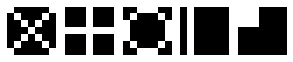

with probabilities:
[0.20 0.20 0.20 0.20 0.20]



 --- Iter #0 --- 
Neurons' weights:


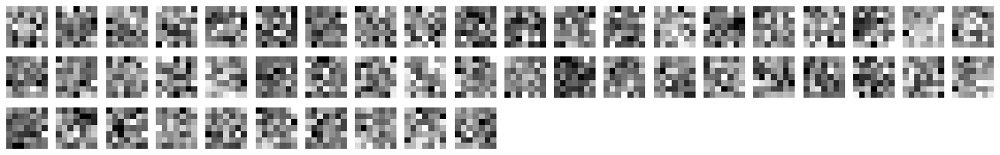

Layer outputs:
[0.31 0.26 0.27 0.19 0.33 0.28 0.29 0.20 0.32 0.34 0.27 0.32 0.28 0.22
 0.39 0.29 0.33 0.32 0.26 0.28 0.30 0.19 0.28 0.25 0.24 0.28 0.27 0.30
 0.27 0.31 0.32 0.35 0.32 0.31 0.22 0.21 0.28 0.30 0.28 0.30 0.20 0.22
 0.33 0.30 0.34 0.25 0.20 0.29 0.34 0.28]

 --- Iter #200 --- 
Neurons' weights:


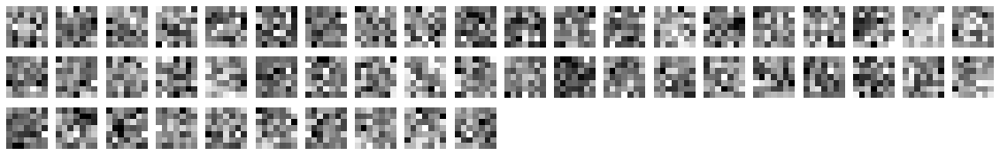

Layer outputs:
[0.32 0.25 0.10 0.27 0.10 0.38 0.50 0.74 0.64 0.74 0.06 0.62 0.14 0.00
 0.36 0.01 0.51 0.14 0.26 0.00 0.25 0.14 0.02 0.32 0.05 0.11 0.03 0.58
 0.74 0.74 0.42 0.52 0.74 0.10 0.26 0.34 0.05 0.20 0.44 0.54 0.17 0.01
 0.74 0.45 0.18 0.31 0.74 0.74 0.37 0.07]

 --- Iter #400 --- 
Neurons' weights:


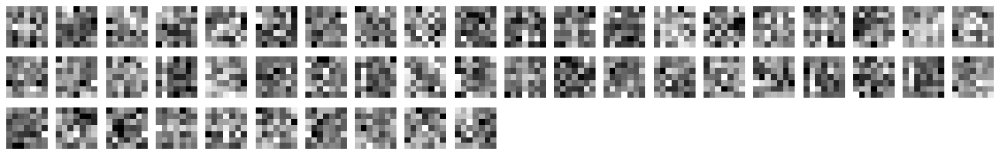

Layer outputs:
[0.38 0.35 0.29 0.20 0.74 0.40 0.40 0.22 0.74 0.48 0.34 0.38 0.39 0.17
 0.74 0.74 0.40 0.74 0.28 0.39 0.47 0.08 0.74 0.31 0.00 0.74 0.49 0.39
 0.36 0.46 0.37 0.74 0.49 0.74 0.00 0.00 0.36 0.74 0.36 0.74 0.00 0.00
 0.41 0.34 0.46 0.25 0.21 0.42 0.74 0.37]

 --- Iter #600 --- 
Neurons' weights:


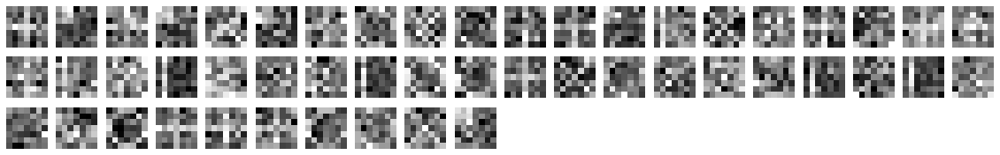

Layer outputs:
[0.34 0.37 0.30 0.27 0.74 0.40 0.33 0.30 0.74 0.44 0.31 0.34 0.39 0.29
 0.74 0.74 0.35 0.74 0.29 0.32 0.36 0.24 0.74 0.33 0.00 0.74 0.37 0.37
 0.38 0.42 0.33 0.74 0.44 0.74 0.00 0.25 0.36 0.74 0.36 0.74 0.00 0.00
 0.40 0.32 0.37 0.28 0.30 0.40 0.74 0.39]

 --- Iter #800 --- 
Neurons' weights:


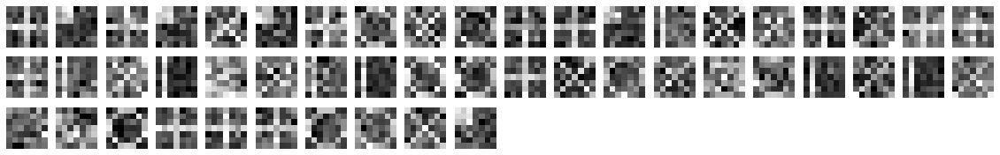

Layer outputs:
[0.30 0.47 0.33 0.43 0.35 0.44 0.28 0.36 0.34 0.41 0.29 0.29 0.46 0.74
 0.34 0.33 0.34 0.32 0.30 0.30 0.29 0.74 0.37 0.74 0.00 0.31 0.74 0.74
 0.31 0.39 0.34 0.33 0.38 0.28 0.00 0.32 0.74 0.32 0.74 0.37 0.00 0.00
 0.36 0.28 0.29 0.28 0.30 0.36 0.37 0.43]

 --- Iter #1000 --- 
Neurons' weights:


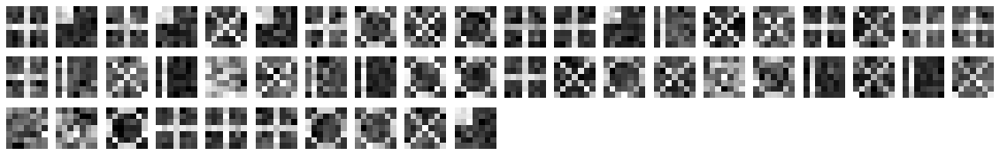

Layer outputs:
[0.31 0.46 0.32 0.44 0.37 0.45 0.29 0.35 0.36 0.39 0.30 0.30 0.46 0.74
 0.36 0.35 0.33 0.35 0.30 0.31 0.30 0.74 0.38 0.74 0.00 0.33 0.74 0.74
 0.32 0.37 0.33 0.35 0.36 0.31 0.00 0.34 0.74 0.34 0.74 0.38 0.00 0.00
 0.36 0.29 0.30 0.29 0.32 0.36 0.38 0.44]

 --- Iter #1200 --- 
Neurons' weights:


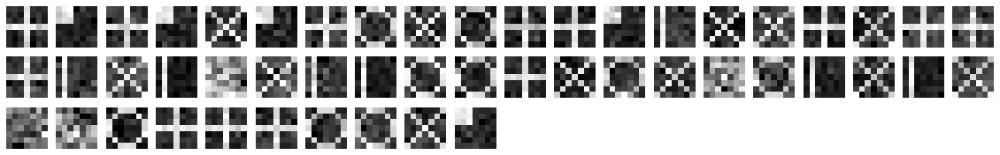

Layer outputs:
[0.39 0.37 0.38 0.38 0.38 0.38 0.40 0.74 0.41 0.74 0.38 0.41 0.37 0.29
 0.39 0.36 0.40 0.39 0.39 0.34 0.39 0.35 0.36 0.35 0.00 0.38 0.32 0.37
 0.74 0.74 0.40 0.40 0.74 0.38 0.00 0.74 0.34 0.39 0.36 0.41 0.00 0.00
 0.74 0.40 0.38 0.39 0.74 0.74 0.40 0.36]

 --- Iter #1400 --- 
Neurons' weights:


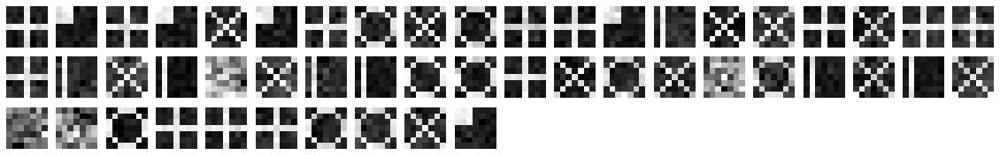

Layer outputs:
[0.74 0.25 0.74 0.25 0.31 0.27 0.74 0.39 0.31 0.40 0.74 0.74 0.26 0.31
 0.29 0.29 0.74 0.30 0.74 0.74 0.74 0.31 0.28 0.31 0.00 0.28 0.31 0.32
 0.38 0.40 0.74 0.29 0.39 0.29 0.00 0.39 0.29 0.27 0.32 0.30 0.00 0.00
 0.39 0.74 0.74 0.74 0.39 0.39 0.30 0.28]

 --- Iter #1600 --- 
Neurons' weights:


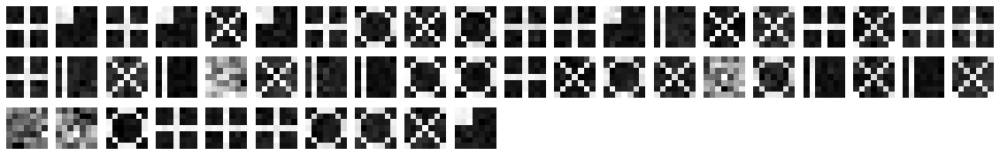

Layer outputs:
[0.74 0.26 0.74 0.26 0.31 0.27 0.74 0.39 0.31 0.40 0.74 0.74 0.26 0.31
 0.30 0.29 0.74 0.30 0.74 0.74 0.74 0.31 0.28 0.31 0.00 0.28 0.31 0.32
 0.39 0.40 0.74 0.29 0.40 0.29 0.00 0.39 0.30 0.28 0.32 0.30 0.00 0.00
 0.39 0.74 0.74 0.74 0.39 0.39 0.30 0.27]

 --- Iter #1800 --- 
Neurons' weights:


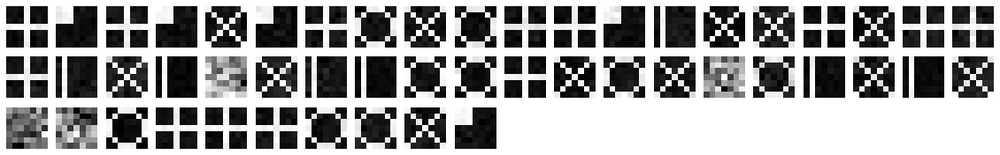

Layer outputs:
[0.40 0.38 0.40 0.38 0.39 0.38 0.40 0.74 0.40 0.74 0.40 0.41 0.38 0.34
 0.39 0.38 0.40 0.39 0.40 0.38 0.40 0.35 0.38 0.35 0.00 0.39 0.34 0.36
 0.74 0.74 0.40 0.39 0.74 0.39 0.00 0.74 0.35 0.39 0.36 0.40 0.00 0.00
 0.74 0.40 0.40 0.40 0.74 0.74 0.39 0.38]

 --- Iter #2000 --- 
Neurons' weights:


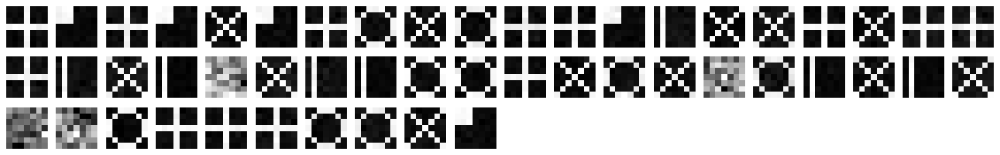

Layer outputs:
[0.40 0.39 0.40 0.39 0.41 0.39 0.40 0.74 0.41 0.74 0.39 0.40 0.39 0.34
 0.41 0.40 0.40 0.41 0.40 0.39 0.40 0.35 0.40 0.35 0.00 0.41 0.34 0.35
 0.74 0.74 0.40 0.41 0.74 0.41 0.00 0.74 0.35 0.41 0.35 0.41 0.00 0.00
 0.74 0.40 0.40 0.40 0.74 0.74 0.41 0.38]

 --- Iter #2200 --- 
Neurons' weights:


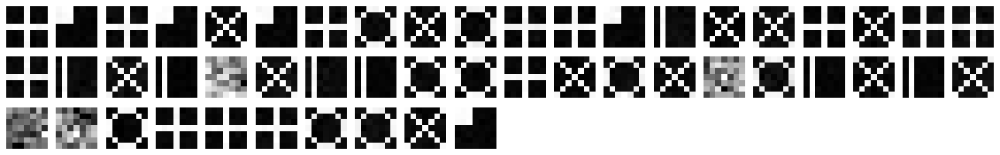

Layer outputs:
[0.74 0.27 0.74 0.27 0.30 0.27 0.74 0.40 0.30 0.40 0.74 0.74 0.27 0.31
 0.30 0.30 0.74 0.30 0.74 0.74 0.74 0.31 0.30 0.31 0.00 0.30 0.31 0.32
 0.40 0.41 0.74 0.30 0.40 0.30 0.00 0.40 0.31 0.30 0.32 0.30 0.00 0.00
 0.40 0.74 0.74 0.74 0.40 0.40 0.30 0.27]

 --- Iter #2400 --- 
Neurons' weights:


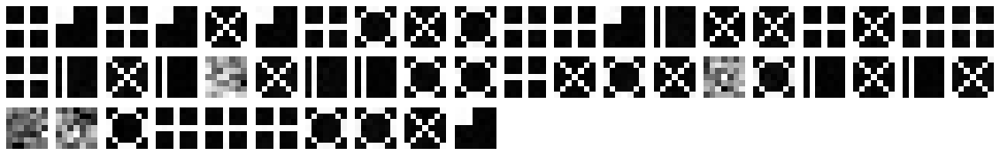

Layer outputs:
[0.30 0.40 0.30 0.40 0.74 0.40 0.30 0.39 0.74 0.40 0.30 0.30 0.40 0.36
 0.74 0.74 0.30 0.74 0.30 0.30 0.30 0.36 0.74 0.36 0.00 0.74 0.36 0.36
 0.40 0.40 0.30 0.74 0.40 0.74 0.00 0.39 0.36 0.74 0.36 0.74 0.00 0.00
 0.40 0.30 0.30 0.30 0.39 0.40 0.74 0.40]

 --- Iter #2600 --- 
Neurons' weights:


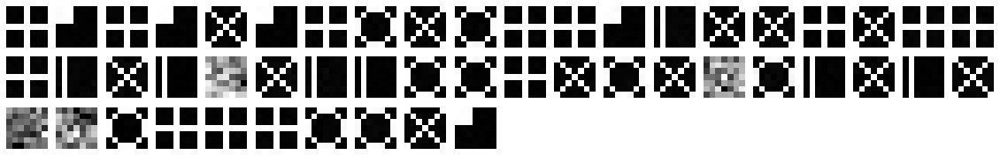

Layer outputs:
[0.74 0.27 0.74 0.27 0.30 0.27 0.74 0.40 0.30 0.40 0.74 0.74 0.27 0.31
 0.30 0.30 0.74 0.30 0.74 0.74 0.74 0.31 0.30 0.31 0.00 0.30 0.31 0.31
 0.39 0.40 0.74 0.30 0.40 0.30 0.00 0.40 0.31 0.30 0.31 0.30 0.00 0.00
 0.40 0.74 0.74 0.74 0.40 0.40 0.30 0.27]

 --- Iter #2800 --- 
Neurons' weights:


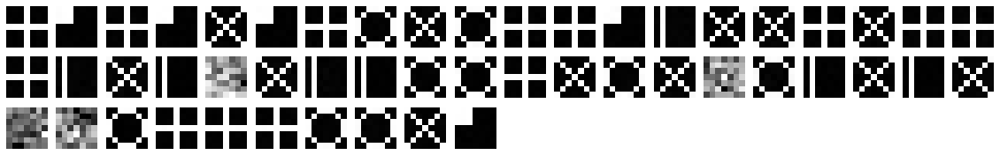

Layer outputs:
[0.74 0.27 0.74 0.27 0.30 0.27 0.74 0.40 0.30 0.40 0.74 0.74 0.27 0.32
 0.30 0.30 0.74 0.30 0.74 0.74 0.74 0.32 0.30 0.32 0.00 0.30 0.32 0.32
 0.40 0.40 0.74 0.30 0.40 0.30 0.00 0.40 0.32 0.30 0.32 0.30 0.00 0.00
 0.40 0.74 0.74 0.74 0.40 0.40 0.30 0.27]

 --- Iter #3000 --- 
Neurons' weights:


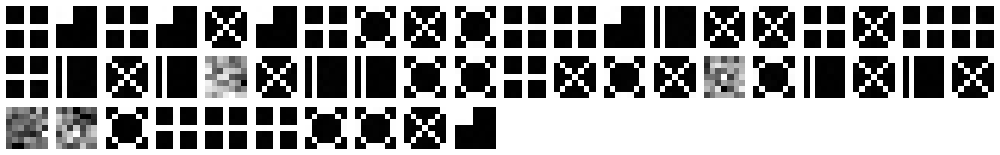

Layer outputs:
[0.27 0.74 0.27 0.74 0.39 0.74 0.27 0.38 0.40 0.38 0.27 0.27 0.74 0.46
 0.40 0.39 0.27 0.39 0.27 0.27 0.27 0.46 0.40 0.46 0.00 0.40 0.46 0.46
 0.38 0.38 0.27 0.39 0.38 0.40 0.00 0.38 0.46 0.40 0.46 0.40 0.00 0.00
 0.38 0.27 0.27 0.27 0.38 0.38 0.40 0.74]

 --- Iter #3200 --- 
Neurons' weights:


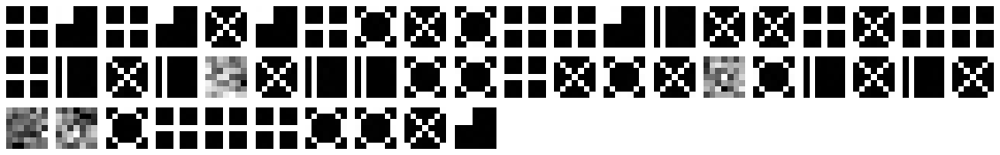

Layer outputs:
[0.31 0.44 0.31 0.44 0.36 0.44 0.31 0.36 0.36 0.36 0.31 0.31 0.44 0.74
 0.36 0.36 0.31 0.36 0.31 0.31 0.31 0.74 0.36 0.74 0.00 0.36 0.74 0.74
 0.36 0.36 0.31 0.36 0.36 0.36 0.00 0.36 0.74 0.36 0.74 0.36 0.00 0.00
 0.36 0.31 0.31 0.31 0.36 0.36 0.36 0.44]

 --- Iter #3400 --- 
Neurons' weights:


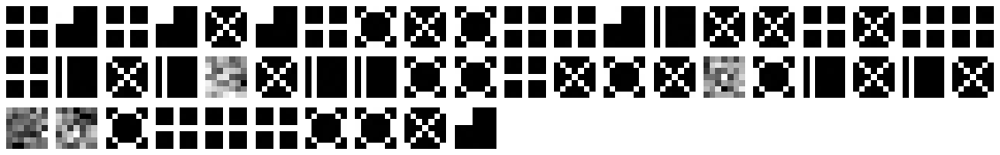

Layer outputs:
[0.74 0.27 0.74 0.27 0.30 0.27 0.74 0.39 0.30 0.39 0.74 0.74 0.27 0.32
 0.30 0.30 0.74 0.30 0.74 0.74 0.74 0.32 0.30 0.32 0.00 0.30 0.32 0.32
 0.39 0.39 0.74 0.30 0.39 0.30 0.00 0.39 0.32 0.30 0.32 0.30 0.00 0.00
 0.39 0.74 0.74 0.74 0.39 0.39 0.30 0.27]

 --- Iter #3600 --- 
Neurons' weights:


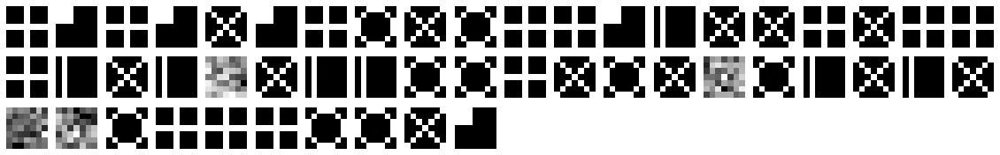

Layer outputs:
[0.40 0.38 0.40 0.38 0.40 0.38 0.40 0.74 0.40 0.74 0.40 0.40 0.38 0.36
 0.40 0.40 0.40 0.40 0.40 0.40 0.40 0.36 0.40 0.36 0.00 0.40 0.36 0.36
 0.74 0.74 0.40 0.40 0.74 0.40 0.00 0.74 0.36 0.40 0.36 0.40 0.00 0.00
 0.74 0.40 0.40 0.40 0.74 0.74 0.40 0.38]

 --- Iter #3800 --- 
Neurons' weights:


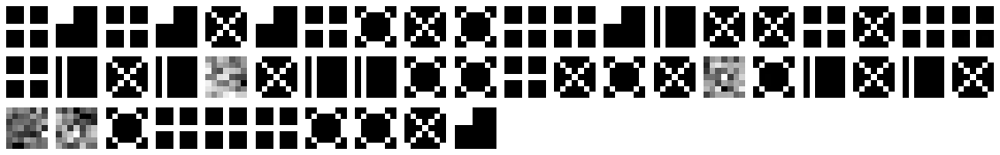

Layer outputs:
[0.32 0.45 0.32 0.44 0.36 0.44 0.32 0.36 0.36 0.36 0.32 0.32 0.45 0.74
 0.36 0.36 0.32 0.36 0.32 0.32 0.32 0.74 0.36 0.74 0.00 0.36 0.74 0.74
 0.36 0.36 0.32 0.36 0.36 0.36 0.00 0.36 0.74 0.36 0.74 0.36 0.00 0.00
 0.36 0.32 0.32 0.32 0.36 0.36 0.36 0.44]

 --- Iter #4000 --- 
Neurons' weights:


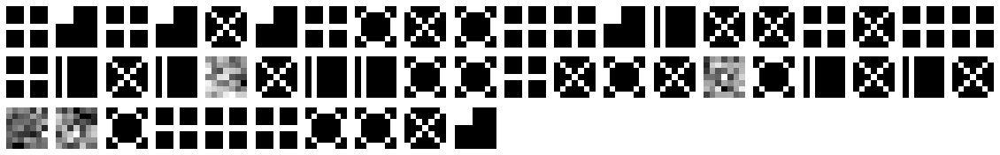

Layer outputs:
[0.31 0.44 0.31 0.44 0.37 0.44 0.31 0.35 0.37 0.35 0.31 0.31 0.44 0.74
 0.37 0.37 0.31 0.37 0.31 0.31 0.31 0.74 0.37 0.74 0.00 0.37 0.74 0.74
 0.35 0.35 0.31 0.37 0.35 0.37 0.00 0.35 0.74 0.37 0.74 0.37 0.00 0.00
 0.35 0.31 0.31 0.31 0.35 0.35 0.37 0.44]

 --- Iter #4200 --- 
Neurons' weights:


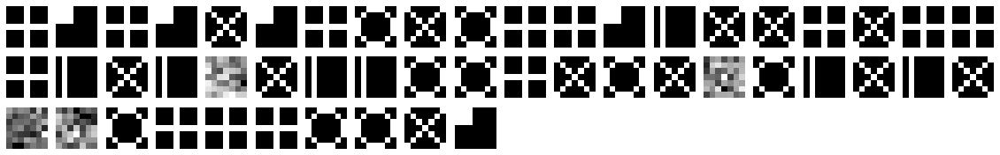

Layer outputs:
[0.30 0.40 0.30 0.40 0.74 0.40 0.30 0.40 0.74 0.40 0.30 0.30 0.40 0.36
 0.74 0.74 0.30 0.74 0.30 0.30 0.30 0.36 0.74 0.36 0.00 0.74 0.36 0.36
 0.40 0.40 0.30 0.74 0.40 0.74 0.00 0.40 0.36 0.74 0.36 0.74 0.00 0.00
 0.40 0.30 0.30 0.30 0.40 0.40 0.74 0.40]

 --- Iter #4400 --- 
Neurons' weights:


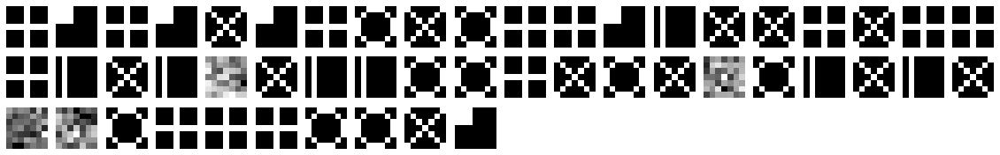

Layer outputs:
[0.40 0.39 0.40 0.39 0.40 0.39 0.40 0.74 0.40 0.74 0.40 0.40 0.39 0.35
 0.40 0.40 0.40 0.40 0.40 0.40 0.40 0.35 0.40 0.35 0.00 0.40 0.35 0.35
 0.74 0.74 0.40 0.40 0.74 0.40 0.00 0.74 0.35 0.40 0.35 0.40 0.00 0.00
 0.74 0.40 0.40 0.40 0.74 0.74 0.40 0.39]

 --- Iter #4600 --- 
Neurons' weights:


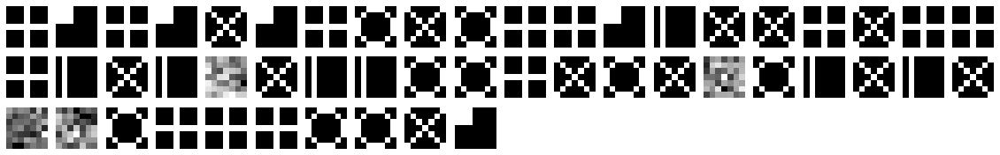

Layer outputs:
[0.74 0.27 0.74 0.27 0.30 0.27 0.74 0.40 0.30 0.40 0.74 0.74 0.27 0.31
 0.30 0.30 0.74 0.30 0.74 0.74 0.74 0.31 0.30 0.31 0.00 0.30 0.31 0.31
 0.40 0.40 0.74 0.30 0.40 0.30 0.00 0.40 0.31 0.30 0.31 0.30 0.00 0.00
 0.40 0.74 0.74 0.74 0.40 0.40 0.30 0.27]

 --- Iter #4800 --- 
Neurons' weights:


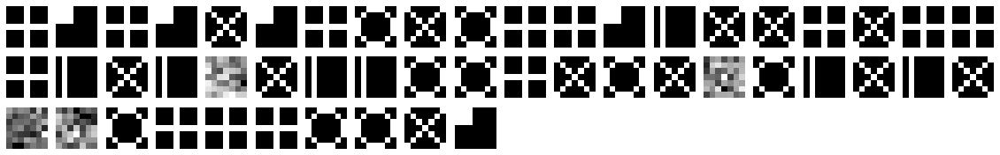

Layer outputs:
[0.31 0.45 0.31 0.45 0.38 0.45 0.31 0.35 0.38 0.35 0.31 0.31 0.45 0.74
 0.38 0.38 0.31 0.38 0.31 0.31 0.31 0.74 0.38 0.74 0.00 0.38 0.74 0.74
 0.35 0.35 0.31 0.38 0.35 0.38 0.00 0.35 0.74 0.38 0.74 0.38 0.00 0.00
 0.35 0.31 0.31 0.31 0.35 0.35 0.38 0.45]


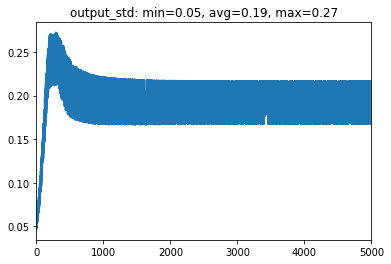

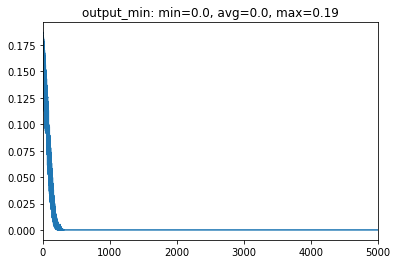

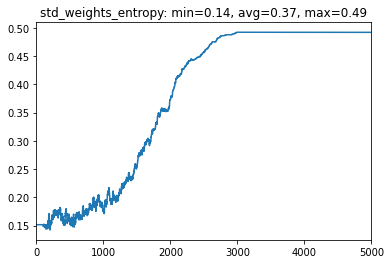

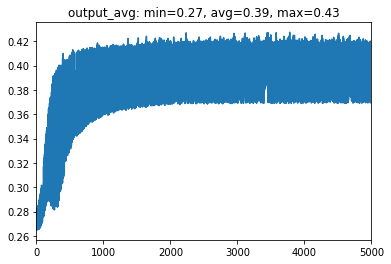

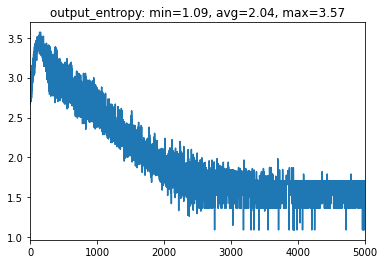

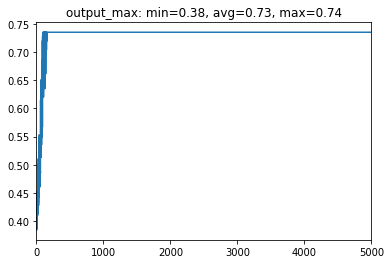

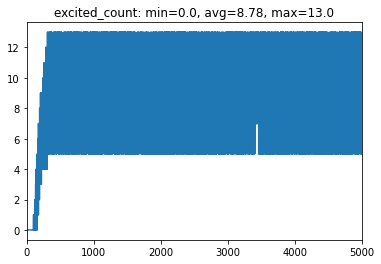

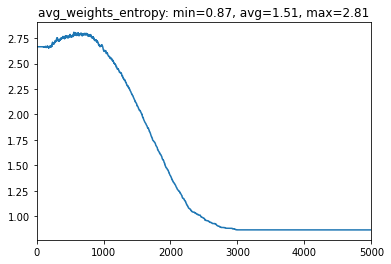

In [192]:
ITERS = 5000 # 50000
NEURONS = 50
THRESHOLD_DECAY=0.01 # 0.0001
WEIGHT_BOOST=0.01 # 0.05
# THRESHOLD_DECAY = 0.0005
# WEIGHT_BOOST = 0.02
DRAW_INTERVAL = 200 # 2000
VERBOSE=False

layer = FastLayer(DIMS[0]*DIMS[1], NEURONS, t_decay=THRESHOLD_DECAY, w_boost=WEIGHT_BOOST)
stats = TrailingStats()

print("\n----------------\nRunning frontprop on following patterns:")
plot_matrix(DIMS, *patterns)
print(f"with probabilities:\n{probs}\n\n")

for i in range(ITERS):

    input_idx = np.random.choice(len(probs), p=probs)
    input = patterns[input_idx].flatten()
    
    if VERBOSE:
        print(f"Iter #{i}: Feeding input pattern #{input_idx}")
        print(input)
        plot_matrix(input)
        
    out = layer.forward(input)
    stats.put(layer.stats())
    
    if i % DRAW_INTERVAL == 0:
        print(f"\n --- Iter #{i} --- ")
        layer.draw(DIMS)
        print("Layer outputs:")
        print(out)
        
stats.report()

## MNIST

In [207]:
import torchvision
import torchvision.datasets as datasets

mnist_trainset = datasets.MNIST(root='./data', train=True, download=True, transform=None)
mnist_train = mnist_trainset.data.cpu().detach().numpy()
mnist_train_labels = mnist_trainset.targets.cpu().detach().numpy()

mnist_testset = datasets.MNIST(root='./data', train=False, download=True, transform=None)
mnist_test = mnist_testset.data.cpu().detach().numpy()
mnist_test_labels = mnist_testset.targets.cpu().detach().numpy()

# normalise to 0-1
mnist_train = mnist_train / 256.0
mnist_test = mnist_test / 256.0

(mnist_train.shape, mnist_train_labels.shape, mnist_test.shape, mnist_test_labels.shape)

((60000, 28, 28), (60000,), (10000, 28, 28), (10000,))


----------------
Running frontprop on MNIST

 === Epoch #0 === 
Neurons' weights:


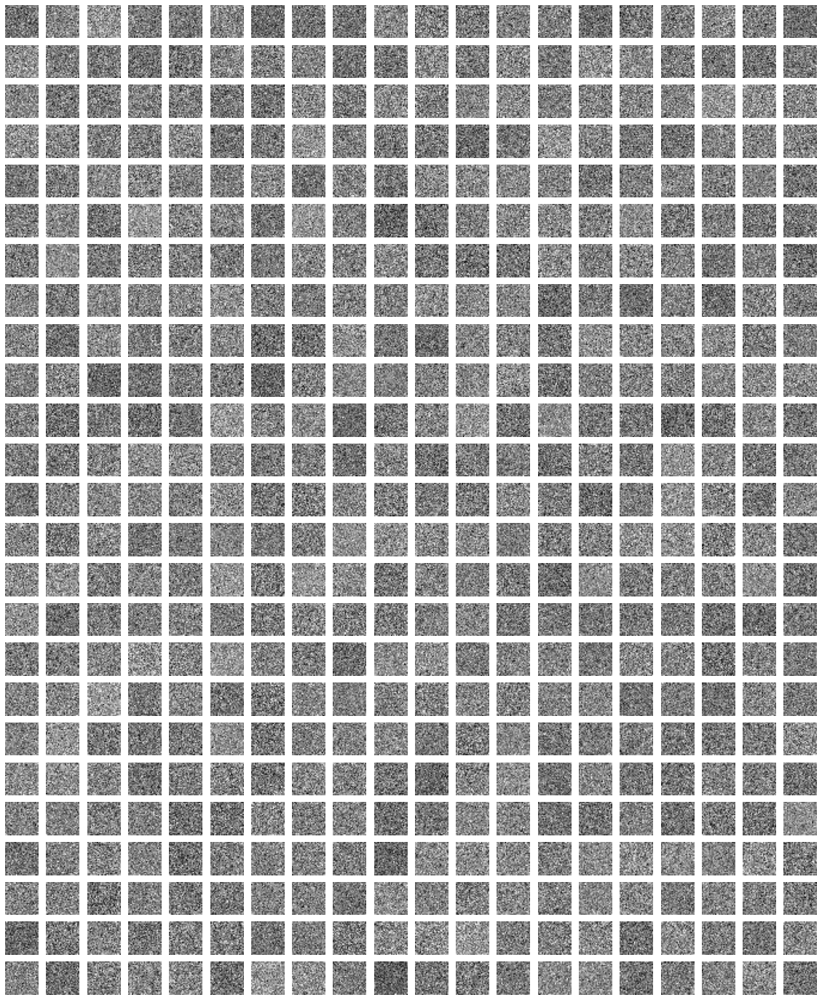

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [07:41<00:00, 129.99it/s]


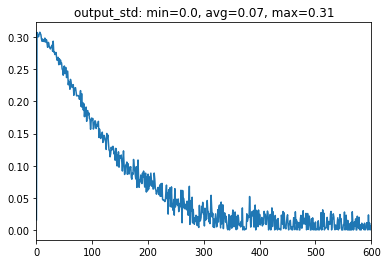

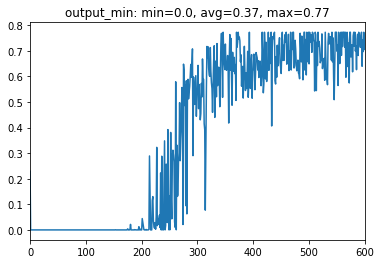

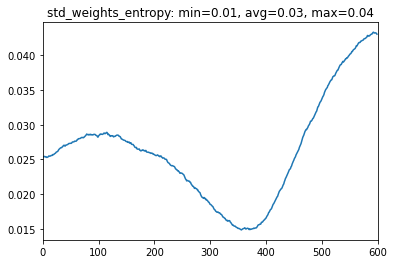

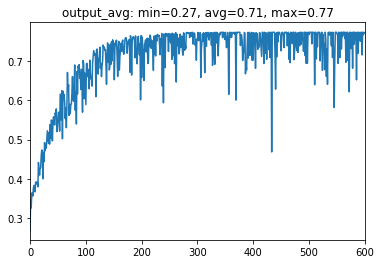

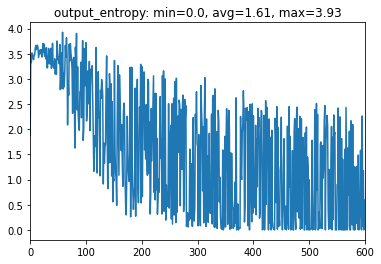

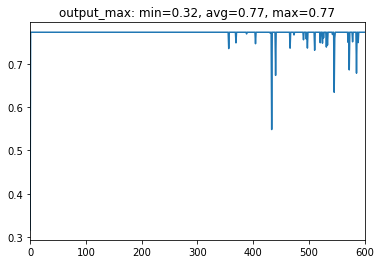

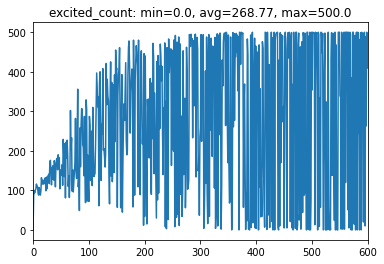

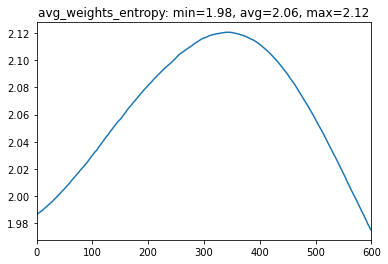

In [218]:
EPOCHS = 1
NEURONS = 500
THRESHOLD_DECAY=0.1
WEIGHT_BOOST=0.0001

DIMS = [28, 28]
STATS_INTERVAL = 100

layer1 = FastLayer(DIMS[0]*DIMS[1], NEURONS, THRESHOLD_DECAY, WEIGHT_BOOST)
stats = TrailingStats()

print("\n----------------\nRunning frontprop on MNIST")

for epoch in range(EPOCHS):
    
    print(f"\n === Epoch #{epoch} === ")
    
    layer1.draw(DIMS)
    
    indices = np.arange(mnist_train.shape[0])
    np.random.shuffle(indices)
    
    for i, input_idx in enumerate(tqdm(indices)):

        input1 = mnist_train[input_idx].flatten()

        out1 = layer1.forward(input1)

        if i % STATS_INTERVAL == 0:
            stats.put(layer1.stats())
    
stats.report()  

Neurons' weights:


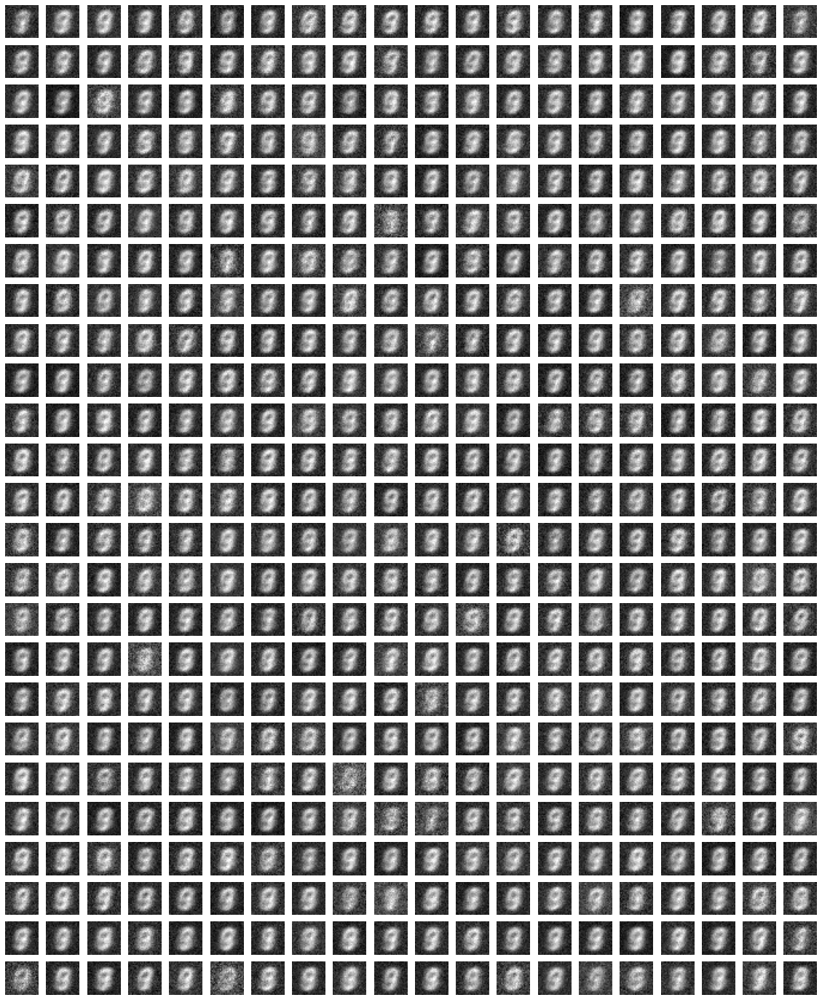

In [219]:
layer1.draw(DIMS)


## TEST

Test the "goodness" of embeddings on the unseen MNIST test dataset.

### Compute embeddings (network outputs)

In [210]:
# first collect outputs for MNIST test samples

def compute_embeddings(layer, data):
    layer.freeze(verbose=False)
    embeddings = np.array([layer.forward(sample.flatten()) for sample in data])
    layer.unfreeze(verbose=False)
    return embeddings
    
def standard_scale(data):
    # standard scaling (0 mean, 1 variance) before we feed into PCA or LogReg
    from sklearn import preprocessing
    return preprocessing.StandardScaler().fit_transform(data)


In [220]:
mnist_train_embeddings = standard_scale(compute_embeddings(layer1, mnist_train))
print(mnist_train_embeddings.shape)
      
mnist_test_embeddings = standard_scale(compute_embeddings(layer1, mnist_test))
print(mnist_test_embeddings.shape)


(60000, 500)
(10000, 500)


### PCA

Use PCA to visualise whether the network outputs cluster well.

In [221]:
def show_pca(data, labels, alpha=0.3, s=15):
    from sklearn.decomposition import PCA
    pca = PCA(n_components=2)
    pca_features = pca.fit_transform(data)
    # plot:
    plt.figure(figsize=(15,10))
    plt.scatter(pca_features[:, 0], pca_features[:, 1],
                c=labels, edgecolor='none', alpha=alpha,
                cmap=plt.cm.get_cmap('tab10', 10), s=s)
    plt.colorbar();
    plt.show()
    

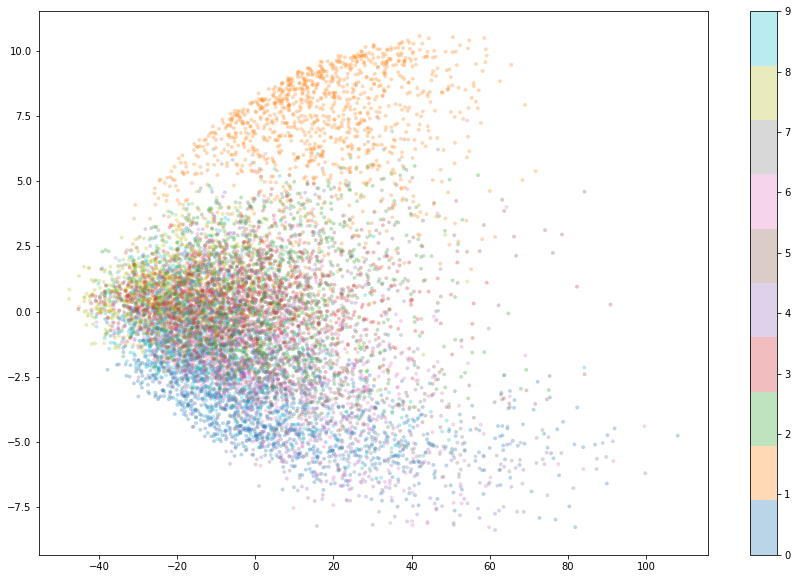

In [222]:

show_pca(mnist_test_embeddings, mnist_test_labels)


## KNN
TODO:
Cluster outputs using KNN, similarly to PCA above.


In [214]:
from sklearn.neighbors import KNeighborsClassifier


In [201]:

# best HP taken from here: https://www.kaggle.com/code/maharshipandya/mnist-using-knn-97
# TODO: search for optimal n_neighbors
KNC = KNeighborsClassifier(n_neighbors=3, weights='distance') 
KNC.fit(mnist_train_1d, mnist_train_labels)
knc_score = KNC.score(mnist_test_1d, mnist_test_labels)
print(knc_score)
knc_score


NameError: name 'mnist_train_1d' is not defined

In [223]:
KNC = KNeighborsClassifier(n_neighbors=3, weights='distance') 
KNC.fit(mnist_train_embeddings, mnist_train_labels)
knc_score = KNC.score(mnist_test_embeddings, mnist_test_labels)
print(knc_score)
knc_score

0.9177


0.9177

### Log Reg

This is similar to the benchmark used in Geoffrey Hinton's paper ("forward-forward", see [here](https://www.cs.toronto.edu/~hinton/FFA13.pdf)).
Use outputs as embeddings and train a simple multi-class Log Reg (aka Softmax) on them.

Results can then be compared with other self-supervised networks, incl the "forward-forward" above.

In [216]:
def logReg_score(train_data, train_labels, test_data, test_labels, max_iter=10000, verbose=0):
    from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
    # TODO: find optimal hyper params - try out different solvers etc
    # TODO: try LogisticRegressionCV
    logReg = LogisticRegression(verbose=verbose, solver = 'lbfgs', multi_class="multinomial", max_iter=max_iter, n_jobs = -1)
    logReg.fit(train_data, train_labels)
    score = logReg.score(test_data, test_labels)
    return score


In [224]:
score = logReg_score(mnist_train_embeddings, mnist_train_labels, mnist_test_embeddings, mnist_test_labels)
score


0.9263

In [73]:
print(score)


0.925


In [ ]:
layer1.save(f"mnist_{layer1.output_size}n_{EPOCHS}ep_{layer1.w_boost}wb_{layer1.t_decay}td_{round(score,4)}score")


# Best score: 0.9614   👀  

# (╯°□°)╯︵ ┻━┻

## Scoreboard

1. `0.9655` - 2000/100/500 neurons, 1 epoch, td = 0.0001, wb = 0.01 (vs untrained `?`)
1. `0.9614` - 2000 neurons, 1 epoch, td = 0.0001, wb = 0.01 (vs untrained `?`)
1. `0.9553` - 2000 neurons, 3 epochs, td = 0.0001, wb = 0.01 (vs untrained `?`)
1. `0.9540` - 1000 neurons, 1 epoch, td = 0.0001, wb = 0.01 (vs untrained `0.9469`)
1. `0.9494` - 500  neurons, 1 epoch, td = 0.0001, wb = 0.01 (vs untrained `0.9314`)
1. `0.9444` - LIN 2000  neurons, 1 epoch, td = 0.1, wb = 0.0001 (vs untrained `?`)
1. `0.9400` - LIN 500  neurons, 1 epoch, td = 0.1, wb = 0.0001 (vs untrained `?`)
1. `0.9318` - 200  neurons, 1 epoch, td = 0.0001, wb = 0.01 (vs untrained `0.9167`)
1. `0.9250` - LIN 2000 neurons, 1 epoch, td = 0.0005, wb = 0.05 (vs untrained `?`)
1. `0.9166` - 100  neurons, 1 epoch, td = 0.0001, wb = 0.01 (vs untrained `0.8927`)
1. `0.7898` - 20   neurons, 1 epoch, td = 0.0001, wb = 0.01 (vs untrained `0.6694`)

## Baselines
Compare the above accuracy with some baselines to relate the performance.
Proposed baselines:
1. An untrained network with randomly initialised weights (kernels). This tests whether training the network improves accuracy.
1. Raw MNIST data, without the network. This tests whether the network generated representation is better than the original features (ie whether the network learned any useful representation of patterns in the data).

### Random weights

Freezing all 100 neurons
Neurons' weights:


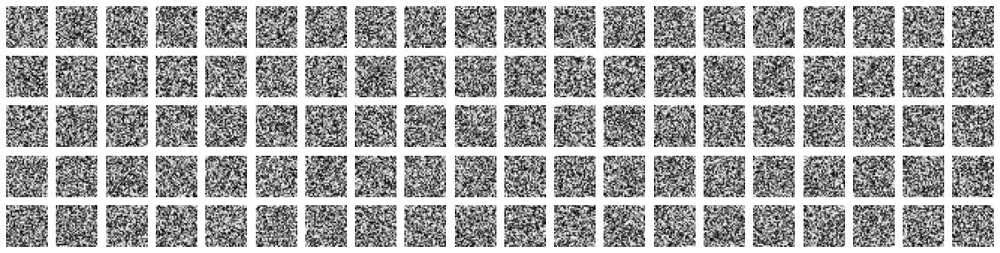

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:01<00:00, 7105.54it/s]

Unfreezing all 100 neurons


In [365]:
# first collect outputs for all MNIST samples

untrained_layer = FastLayer(DIMS[0]*DIMS[1], NEURONS)
untrained_layer.freeze()
untrained_layer.draw(DIMS)

untrained_embeddings = standard_scale(compute_embeddings(untrained_layer, mnist_train))
untrained_test_embeddings = standard_scale(compute_embeddings(untrained_layer, mnist_test))


In [367]:
untrained_logReg = logReg_score(untrained_embeddings, mnist_train_labels, 
                                untrained_test_embeddings, mnist_test_labels)
untrained_score

0.8927

In [337]:
print(untrained_score)

0.6694


### Only LogReg
Plain Log Reg, without the network, directly on MNIST features.
Typical accuracy ~0.92-0.93

In [296]:

# flatten 2D images to continous vectors
mnist_train_1d = np.reshape(mnist_train, newshape=(mnist_train.shape[0], mnist_train.shape[1]**2))
mnist_test_1d = np.reshape(mnist_test, newshape=(mnist_test.shape[0], mnist_test.shape[1]**2))

# standard preprocessing (0 mean, 1 variance) before we feed into LogReg 
mnist_train_scaled = preprocessing.StandardScaler().fit_transform(mnist_train_1d)
mnist_test_scaled = preprocessing.StandardScaler().fit_transform(mnist_test_1d)


In [297]:
raw_logreg_score = logReg_score(mnist_train_1d, mnist_train_labels,
                                raw_logReg.score(mnist_test_1d, mnist_test_labels)
raw_logreg_score

0.9257

In [298]:
print(raw_logreg_score)

0.9257




---




---


In [ ]:
# TODO
# see if normalising output by distance is better than normalising by max
# CHERRY PICK top 10 highest activated neurons per digit 
#     and create a synthetic layer and benchmark it against random 100
# compute score every X iterations and add to stats (need train/val split)
# benchmark each layer separately, plus LogReg on ALL outputs combined.
# HP search
# repulsion mechanism - Lateral Inhibition
# mini-batch
# torch impl

## Weights analysis

Highest activating neurons for digit 0
Neurons indices: [281 427  47 161 396 296  14 365  88 358 331  52 137 493 290 186 298 132
 491 486 334 437  87 428 163 429 203 116 386 254 490 230 118  41 311 175
  10  58 319 140]


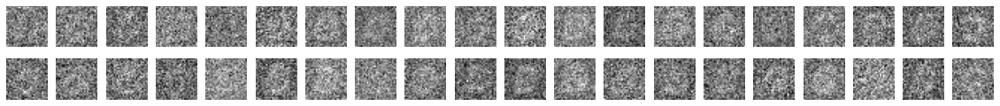

Highest activating neurons for digit 1
Neurons indices: [384 242 419 183 363 425 484  56  69 276 303 422 195 333 408 191 231 125
 199 236   5  31 345 247 182 369  24 447 378 124 442  87  49 165 147 453
  29 178  99 269]


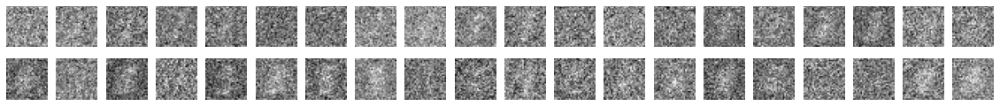

Highest activating neurons for digit 2
Neurons indices: [413  29 422 183 165 231  56 363 198 378 309   6 385 411 259 178  49 326
 143 236 468 453 254 124 475 170 333 187 157 434  74 115 242 112 485 215
  70 472 152 123]


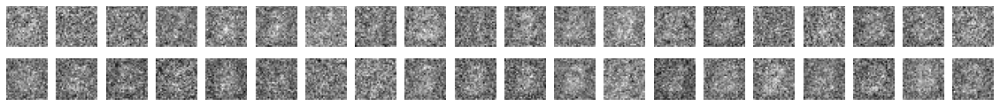

Highest activating neurons for digit 3
Neurons indices: [484 384 138 469 123 182 116 236 436  36 473 465 303 471  24 261 377 452
  87 459 434 157  41 344 354 191 369 329 424 315 349 318 437 390 221 239
 108 305 125 277]


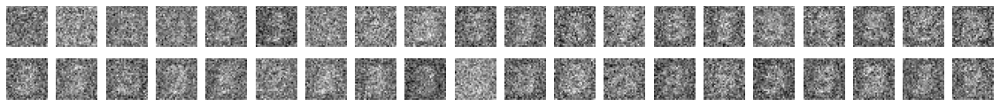

Highest activating neurons for digit 4
Neurons indices: [247 228 178 433 442 173 279 348 464 208 170 409 180 101 195 416 492  12
 413 455 270 299 167  37 275 466 469 449  30 316 119  82 285 380  93 218
 189 164 249  58]


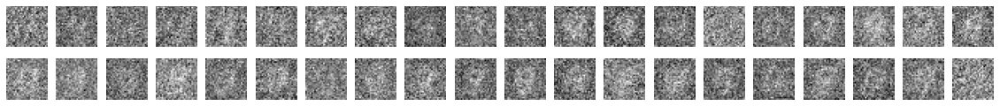

Highest activating neurons for digit 5
Neurons indices: [384 163 118 116 334 161  57 354   9 437 428 427 411  87 248 138  88 226
 431 202 103 294  41 322 246  34  36 182  35 296 108 217 156 268 286 477
 358 349 315 495]


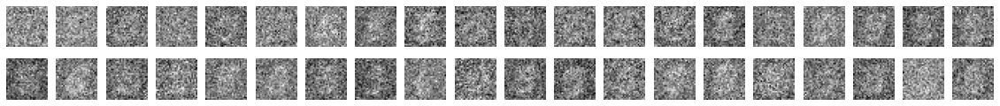

Highest activating neurons for digit 6
Neurons indices: [348 260 435 122   6 137 254 101  42 171 439  35 281 198 307  98 166 230
   5  86 415  62 211 106 143  47  57 212 367 154 163  63 493 468 399 378
 339 475 152 178]


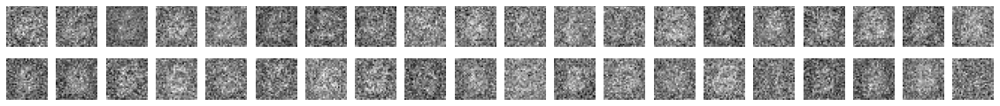

Highest activating neurons for digit 7
Neurons indices: [195 208  31 442 228 187  58 199 425 153 428 373 127 396   2 433 167 172
 173 217 299  30 275 460 247 486 469 346  40 227 126 139 117 184 140 298
 255 279  93 316]


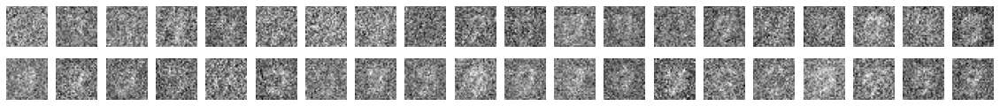

Highest activating neurons for digit 8
Neurons indices: [ 24 333 165 242 125 238 221 204 434 363  50 189 147 278 159 452 285 368
 256 160 191 157 215 394 220 369 320 104  37 405 224 420  49 473  78 430
 231 447 408 246]


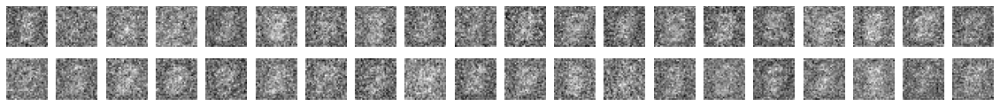

Highest activating neurons for digit 9
Neurons indices: [208 442 228 247 173 299  93 433   2 127 338  27 474 316 464 178  42  30
 416  12 180 373 455 237 279 131 117  37 428 492 119 371  71 381 351 227
  85 257 426 393]


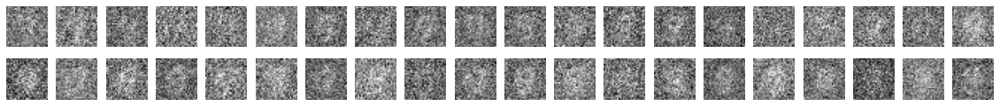

In [137]:

N = 40
topN_kernels_for_digit = []

for digit in range(10):
    print(f"Highest activating neurons for digit {digit}")
    
    digit_indices = (mnist_train_labels == digit).nonzero()[0]
    digit_outputs = mnist_train_embeddings[digit_indices]
    digit_outputs_sum = np.sum(digit_outputs, axis = 0)
    # get indices of top N neurons with highest sums
    # https://stackoverflow.com/questions/6910641/how-do-i-get-indices-of-n-maximum-values-in-a-numpy-array
    topN_neurons_indices = np.argpartition(digit_outputs_sum, -N)[-N:]
    topN_neurons_indices = topN_neurons_indices[np.argsort(digit_outputs_sum[topN_neurons_indices])]
    topN_neurons_indices = np.flip(topN_neurons_indices)
    # save them
    topN_kernels_for_digit.append(layer1.W[topN_neurons_indices])
    # draw them
    print(f"Neurons indices: {topN_neurons_indices}")
    plot_matrix(DIMS, *([w for w in layer1.W[topN_neurons_indices]]))
    
    
topN_kernels_for_digit = np.array(topN_kernels_for_digit)

In [138]:
topN_kernels_for_digit.shape


(10, 40, 784)

In [139]:
topN_kernels_for_digit.reshape(10*40, 784).shape


(400, 784)

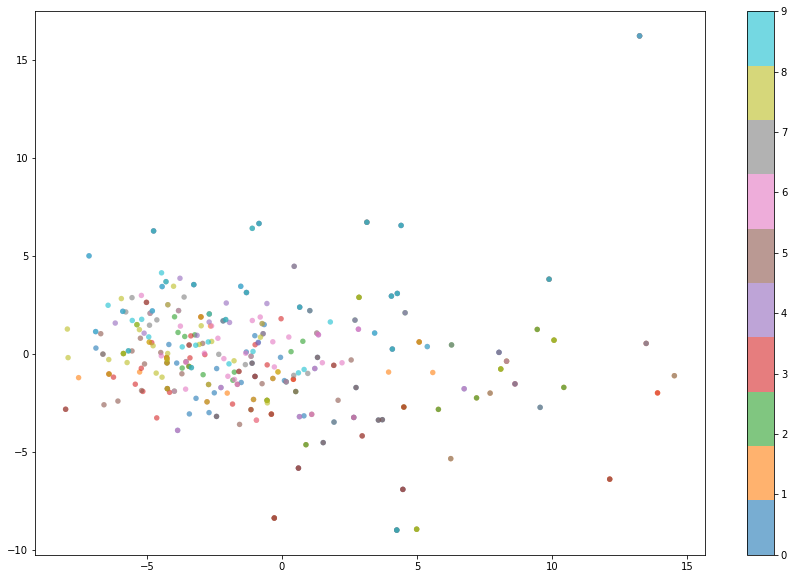

In [140]:

show_pca(topN_kernels_for_digit.reshape(10*40, 784), 
         np.concatenate([np.repeat(i, 40) for i in range(10)]),
         s=30, alpha=0.6)


## HP search

In [204]:

def benchmark_score(layer):
#     layer.freeze()
    mnist_train_embeddings = standard_scale(compute_embeddings(layer, mnist_train))
    mnist_test_embeddings = standard_scale(compute_embeddings(layer, mnist_test))
    score = logReg_score(mnist_train_embeddings, mnist_train_labels, mnist_test_embeddings, mnist_test_labels)
#     layer.unfreeze()
    return score


In [205]:

EPOCHS = 1
NEURONS = [200]
THRESHOLD_DECAYS=[0.1,.01,.001,.0001,.00001]
WEIGHT_BOOSTS=[0.1,.01,.001,.0001,.00001]

DIMS = [28, 28]
BENCHMARK_INTERVAL = 20000

results = []
best_score = 0
best_res = None
best_W = None

for N in NEURONS:
    for TD in THRESHOLD_DECAYS:
        for WB in WEIGHT_BOOSTS:
            L = FastLayer(DIMS[0]*DIMS[1], N, TD, WB)

            print(f"HP:\t{N}\t{TD}\t{WB}")

            i=0
            for epoch in range(EPOCHS):

                print(f"Epoch {epoch}")
                indices = np.arange(mnist_train.shape[0])
                np.random.shuffle(indices)

                for input_idx in indices:

                    i+=1
                    features = mnist_train[input_idx].flatten()
                    out = L.forward(features)

                    if i % BENCHMARK_INTERVAL == 0:
                        score = benchmark_score(L)
                        #print(score)
                        results.append([N,TD,WB,i,score])
                        # print(f"iter #{i} \t score {score}")
                        if score > best_score:
                            print(f"NEW BEST SCORE:\t{score} (from {best_score})\titer {i}\tHP:\t{N}\t{TD}\t{WB}")
                            best_score = score
                            best_W = L.W
                            best_res = [N,TD,WB,i]
                            


HP:	200	0.1	0.1
Epoch 0
NEW BEST SCORE:	0.1739 (from 0)	iter 20000	HP:	200	0.1	0.1
NEW BEST SCORE:	0.2044 (from 0.1739)	iter 40000	HP:	200	0.1	0.1
HP:	200	0.1	0.01
Epoch 0
HP:	200	0.1	0.001
Epoch 0
NEW BEST SCORE:	0.6555 (from 0.2044)	iter 20000	HP:	200	0.1	0.001
HP:	200	0.1	0.0001
Epoch 0
NEW BEST SCORE:	0.9245 (from 0.6555)	iter 20000	HP:	200	0.1	0.0001
HP:	200	0.1	1e-05
Epoch 0
HP:	200	0.01	0.1
Epoch 0
HP:	200	0.01	0.01
Epoch 0
HP:	200	0.01	0.001
Epoch 0
HP:	200	0.01	0.0001
Epoch 0
HP:	200	0.01	1e-05
Epoch 0
HP:	200	0.001	0.1
Epoch 0
HP:	200	0.001	0.01
Epoch 0
HP:	200	0.001	0.001
Epoch 0
HP:	200	0.001	0.0001
Epoch 0
NEW BEST SCORE:	0.9251 (from 0.9245)	iter 40000	HP:	200	0.001	0.0001
HP:	200	0.001	1e-05
Epoch 0
HP:	200	0.0001	0.1
Epoch 0
HP:	200	0.0001	0.01
Epoch 0
HP:	200	0.0001	0.001
Epoch 0
HP:	200	0.0001	0.0001
Epoch 0
HP:	200	0.0001	1e-05
Epoch 0
HP:	200	1e-05	0.1
Epoch 0
HP:	200	1e-05	0.01
Epoch 0
HP:	200	1e-05	0.001
Epoch 0
HP:	200	1e-05	0.0001
Epoch 0
HP:	200	1e-05	1e-05
Epo

In [206]:
print(f"Best results {best_res}")
hp_search_results = np.array(results)
np.save('hp_LIN_NORM_search_results', hp_search_results)
np.save('hp_LIN_NORM_search_best_res', np.array(best_res))
np.save(f"hp_LIN_NORM_search_best_W_{best_score}", best_W)

Best results [200, 0.001, 0.0001, 40000]


NEW BEST SCORE:	0.907 (from 0.2599)	iter 10000	HP:	1	100	0.1	0.001
NEW BEST SCORE:	0.9081 (from 0.907)	iter 20000	HP:	1	100	0.1	0.0005
NEW BEST SCORE:	0.9103 (from 0.9081)	iter 30000	HP:	1	100	0.1	0.0005

NEW BEST SCORE:	0.9263 (from 0.9251)	iter 80000	HP:	100	0.001	0.0005

NEW BEST SCORE:	0.9292 (from 0.9287)	iter 60000	HP:	100	0.0001	0.005

NEW BEST SCORE:	0.9349 (from 0.9292)	iter 10000	HP:	500	0.1	0.0001

## Multi layer


----------------
Running frontprop on MNIST
Neurons' weights:


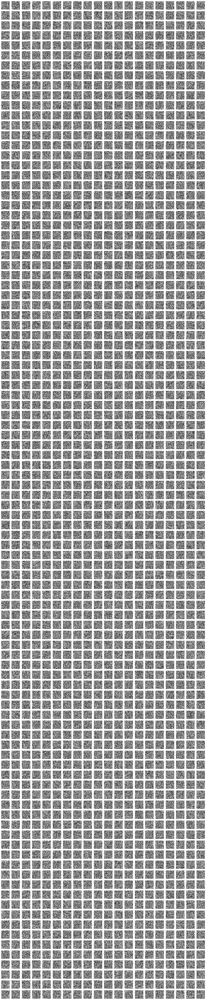

Neurons' weights:


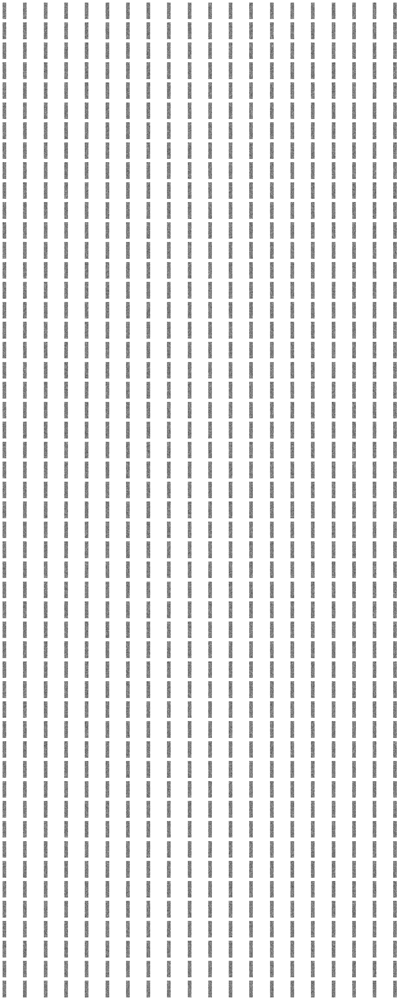

Neurons' weights:


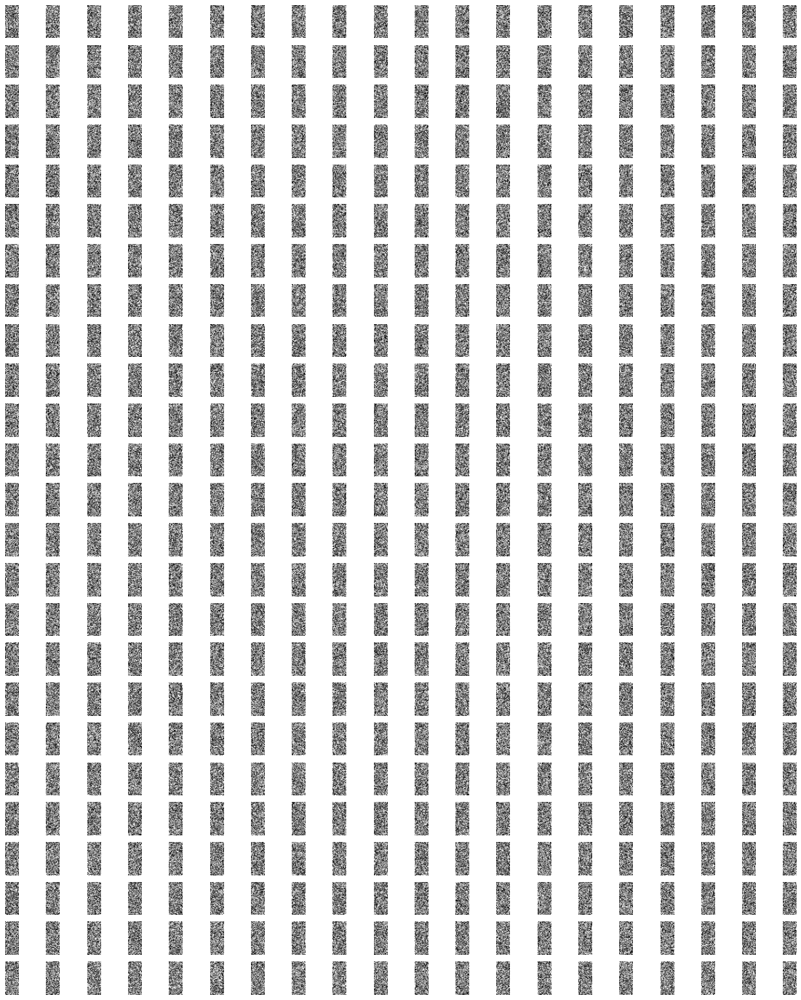

Training layer 1


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [25:31<00:00, 39.17it/s]


Layer 1:
Neurons' weights:


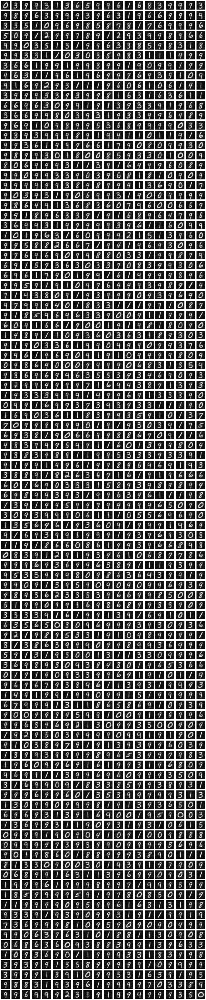

Freezing all 2000 neurons
Training layer 2


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [44:39<00:00, 22.39it/s]


Layer 2:
Neurons' weights:


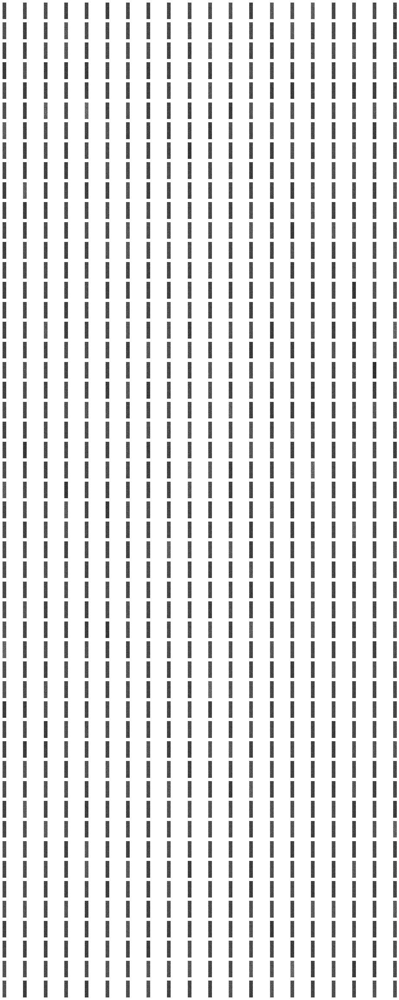

Freezing all 1000 neurons
Training layer 3


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [27:24<00:00, 36.48it/s]


Layer 3:
Neurons' weights:


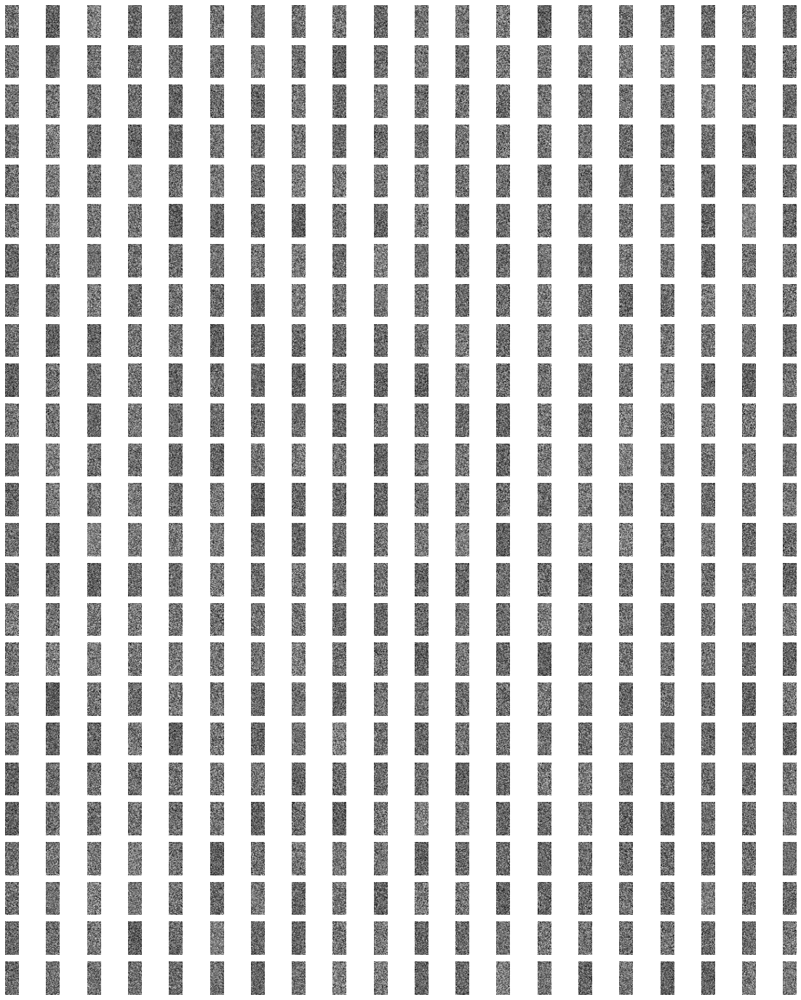

Freezing all 500 neurons


In [446]:

L1_SIZE = 2000
L2_SIZE = 1000
L3_SIZE = 500

THRESHOLD_DECAY=0.0001
WEIGHT_BOOST=0.01

DIMS = [28, 28]

L1 = FastLayer(DIMS[0]*DIMS[1], L1_SIZE, THRESHOLD_DECAY, WEIGHT_BOOST)
L2 = FastLayer.After(L1, L2_SIZE, THRESHOLD_DECAY, WEIGHT_BOOST)
L3 = FastLayer.After(L2, L3_SIZE, THRESHOLD_DECAY, WEIGHT_BOOST)

# TODO
# stats = TrailingStats()

print("\n----------------\nRunning frontprop on MNIST")

L1.draw(DIMS)
L2.draw([int(L1_SIZE/20),20])
L3.draw([int(L2_SIZE/20),20])

indices = np.arange(mnist_train.shape[0])
np.random.shuffle(indices)

print("Training layer 1")
for i, input_idx in enumerate(tqdm(indices)):
    features = mnist_train[input_idx].flatten()
    output = L1.forward(features)

print("Layer 1:")
L1.draw(DIMS)
L1.freeze()

print("Training layer 2")
for i, input_idx in enumerate(tqdm(indices)):
    features = mnist_train[input_idx].flatten()
    out1 = L1.forward(features)
    out2 = L2.forward(out1)

print("Layer 2:")
L2.draw([int(L1_SIZE/20),20])
L2.freeze()

print("Training layer 3")
for i, input_idx in enumerate(tqdm(indices)):
    features = mnist_train[input_idx].flatten()
    out1 = L1.forward(features)
    out2 = L2.forward(out1)
    out3 = L3.forward(out2)

print("Layer 3:")
L3.draw([int(L2_SIZE/20),20])
L3.freeze()

In [447]:
L1_train_embeddings = compute_embeddings(L1, mnist_train)
L2_train_embeddings = compute_embeddings(L2, L1_train_embeddings)
L3_train_embeddings = compute_embeddings(L3, L2_train_embeddings)

Freezing all 2000 neurons


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [09:34<00:00, 104.50it/s]


Freezing all 1000 neurons


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [12:16<00:00, 81.51it/s]


Freezing all 500 neurons


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 60000/60000 [01:34<00:00, 636.45it/s]


In [448]:
L1_train_embeddings = standard_scale(L1_train_embeddings)
L2_train_embeddings = standard_scale(L2_train_embeddings)
L3_train_embeddings = standard_scale(L3_train_embeddings)

In [449]:

L1_test_embeddings = compute_embeddings(L1, mnist_test)
L2_test_embeddings = compute_embeddings(L2, L1_test_embeddings)
L3_test_embeddings = compute_embeddings(L3, L2_test_embeddings)


Freezing all 2000 neurons


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [01:37<00:00, 102.16it/s]


Freezing all 1000 neurons


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [02:05<00:00, 79.72it/s]


Freezing all 500 neurons


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:12<00:00, 786.20it/s]


In [450]:
L1_test_embeddings = standard_scale(L1_test_embeddings)
L2_test_embeddings = standard_scale(L2_test_embeddings)
L3_test_embeddings = standard_scale(L3_test_embeddings)

In [451]:

L1_score = logReg_score(L1_train_embeddings, mnist_train_labels, L1_test_embeddings, mnist_test_labels)
L2_score = logReg_score(L2_train_embeddings, mnist_train_labels, L2_test_embeddings, mnist_test_labels)
L3_score = logReg_score(L3_train_embeddings, mnist_train_labels, L3_test_embeddings, mnist_test_labels)


In [452]:
print(L1_score, L2_score, L3_score)


0.9643 0.929 0.847


500/100/50: ```0.9488 0.8881 0.7563```


In [453]:

# combined score
combined_train_embeddings = np.hstack((L1_train_embeddings, L2_train_embeddings, L3_train_embeddings))
combined_test_embeddings = np.hstack((L1_test_embeddings, L2_test_embeddings, L3_test_embeddings))

all_layers_score = logReg_score(combined_train_embeddings, mnist_train_labels, 
                                combined_test_embeddings, mnist_test_labels)

In [454]:
print(all_layers_score)


0.9655


500/100/50: ```0.9515```